# Text Analytics Group Project

Done by: 
Chien Chen Liew (261178093)
Farah Hoque (261149217)
Hao Hao Duong (261104689)
Jared Balakrishnan (261175926)
Seunghyun Park (260686853) 

## 1a. Import Libraries

In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns                 
import matplotlib.pyplot as plt      
from sklearn.feature_extraction.text import TfidfVectorizer
#%matplotlib inline     
sns.set(color_codes=True)
#import tensorflow_text
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
#Import matplotlib

from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import TruncatedSVD
from tqdm import tqdm
import nltk
from nltk import word_tokenize
from nltk.corpus import stopwords
# nltk.download('stopwords')
stop_words = stopwords.words('english')
import string
from nltk.tag import pos_tag
from nltk.stem import WordNetLemmatizer
from nltk.corpus.reader.wordnet import NOUN, VERB, ADV, ADJ
import nltk
#nltk.download('popular')
from gensim.test.utils import common_texts
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from sklearn.feature_extraction.text import TfidfVectorizer

import plotly.express as px

from wordcloud import WordCloud

## 1b. Import Dataset

In [2]:
df=pd.read_csv('/Users/chien/Downloads/Hotel_Reviews.csv')

## 2. Exploratory Data Analysis

In [3]:
df.shape

(515738, 17)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   Hotel_Address                               515738 non-null  object 
 1   Additional_Number_of_Scoring                515738 non-null  int64  
 2   Review_Date                                 515738 non-null  object 
 3   Average_Score                               515738 non-null  float64
 4   Hotel_Name                                  515738 non-null  object 
 5   Reviewer_Nationality                        515738 non-null  object 
 6   Negative_Review                             515738 non-null  object 
 7   Review_Total_Negative_Word_Counts           515738 non-null  int64  
 8   Total_Number_of_Reviews                     515738 non-null  int64  
 9   Positive_Review                             515738 non-null  object 
 

In [5]:
df.describe()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,lat,lng
count,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,512470.000000,512470.000000
mean,498.081836,8.397487,18.539450,2743.743944,17.776458,7.166001,8.395077,49.442439,2.823803
std,500.538467,0.548048,29.690831,2317.464868,21.804185,11.040228,1.637856,3.466325,4.579425
min,1.000000,5.200000,0.000000,43.000000,0.000000,1.000000,2.500000,41.328376,-0.369758
25%,169.000000,8.100000,2.000000,1161.000000,5.000000,1.000000,7.500000,48.214662,-0.143372
50%,341.000000,8.400000,9.000000,2134.000000,11.000000,3.000000,8.800000,51.499981,0.010607
75%,660.000000,8.800000,23.000000,3613.000000,22.000000,8.000000,9.600000,51.516288,4.834443
max,2682.000000,9.800000,408.000000,16670.000000,395.000000,355.000000,10.000000,52.400181,16.429233


In [6]:
df.nunique()

Hotel_Address                                   1493
Additional_Number_of_Scoring                     480
Review_Date                                      731
Average_Score                                     34
Hotel_Name                                      1492
Reviewer_Nationality                             227
Negative_Review                               330011
Review_Total_Negative_Word_Counts                402
Total_Number_of_Reviews                         1142
Positive_Review                               412601
Review_Total_Positive_Word_Counts                365
Total_Number_of_Reviews_Reviewer_Has_Given       198
Reviewer_Score                                    37
Tags                                           55242
days_since_review                                731
lat                                             1472
lng                                             1472
dtype: int64

In [7]:
df.isnull().sum()

Hotel_Address                                    0
Additional_Number_of_Scoring                     0
Review_Date                                      0
Average_Score                                    0
Hotel_Name                                       0
Reviewer_Nationality                             0
Negative_Review                                  0
Review_Total_Negative_Word_Counts                0
Total_Number_of_Reviews                          0
Positive_Review                                  0
Review_Total_Positive_Word_Counts                0
Total_Number_of_Reviews_Reviewer_Has_Given       0
Reviewer_Score                                   0
Tags                                             0
days_since_review                                0
lat                                           3268
lng                                           3268
dtype: int64

In [8]:
fig = px.histogram(df, x="Reviewer_Score", title='Review Score Distribution', nbins=20, text_auto=True)
fig.show()

In [9]:
fig = px.histogram(df, x="Average_Score", title='Review Average Score Distribution')
fig.show()

1. Review score is left-skewed, meaning there are fewer low scores and a concentration of higher scores.
2. Average score distribution is right-skewed, indicating that more hotels have higher average scores.

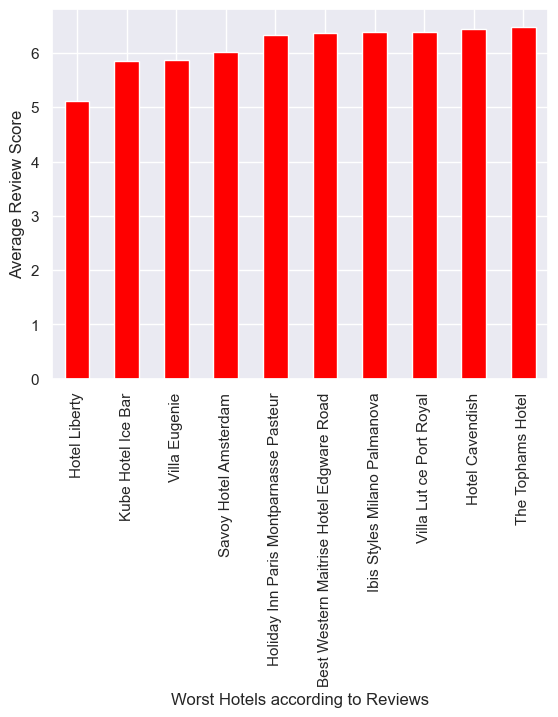

In [10]:
#Worst Hotels
worst_hotels =df.groupby('Hotel_Name')['Reviewer_Score'].mean().sort_values(ascending=True).head(10)
worst_hotels.plot(kind="bar",color="red")
_=plt.xlabel('Worst Hotels according to Reviews')
_=plt.ylabel('Average Review Score')
plt.show()

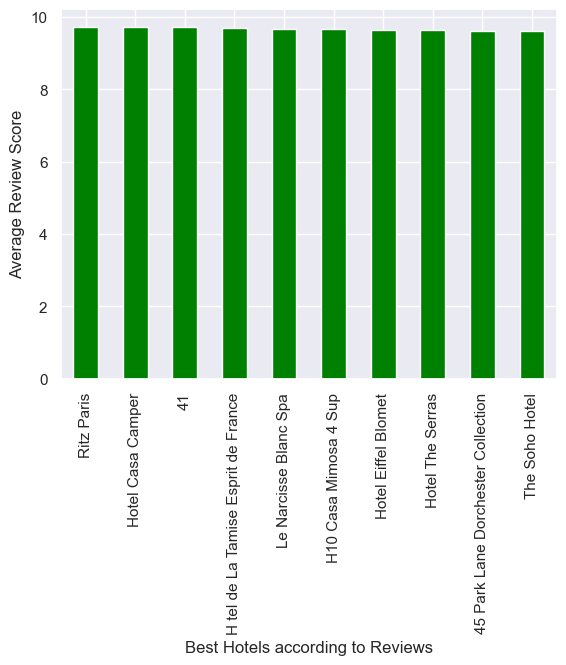

In [11]:
#Best Hotels
best_hotels = df.groupby('Hotel_Name')['Reviewer_Score'].mean().sort_values(ascending=False).head(10)
best_hotels.plot(kind="bar",color = "Green")
_=plt.xlabel('Best Hotels according to Reviews')
_=plt.ylabel('Average Review Score')
plt.show()

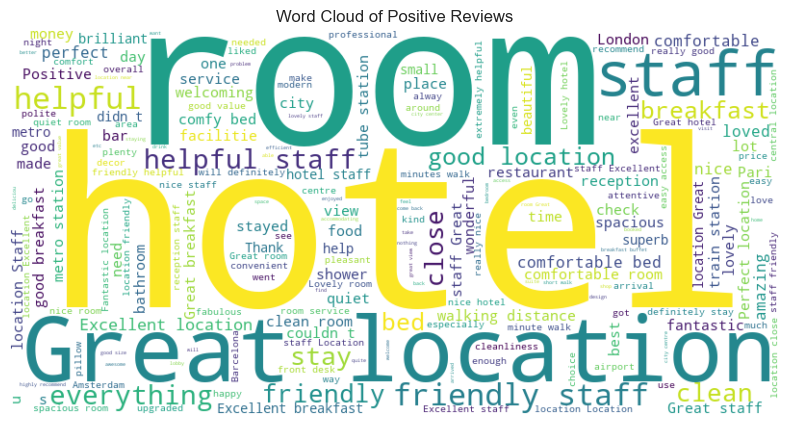

In [12]:
text = " ".join(df[df["Reviewer_Score"] >= 8]["Positive_Review"])
# Generate a word cloud image with white background
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Display the generated image using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Word Cloud of Positive Reviews")
plt.axis("off")  # Do not show axis to keep it clean
plt.show()

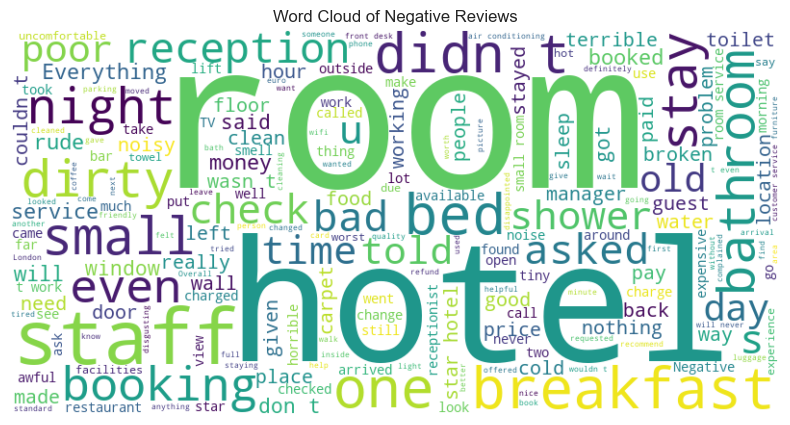

In [13]:
# Generating the text as a combination of negative reviews with Reviewer_Score <= 4
text2 = " ".join(review for review in df[df["Reviewer_Score"] <= 4]["Negative_Review"])

# Generate a word cloud image with white background
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text2)

# Display the generated image using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Word Cloud of Negative Reviews")
plt.axis("off")  # Do not show axis to keep it clean
plt.show()

The word cloud suggests that cleanliness, room size, and customer service are recurring themes in negative reviews, which hotel management might want to address to improve guest satisfaction.

## 3. Pre-Processing

In [14]:
# resample the dataset to reduce computational costs for models
df = df.sample(n=5000, random_state=42)

### 3a. Create a City and Country Column in the DataFrame

In [15]:
# Function to extract city and country
def extract_city_country(address):
    words = address.split(" ")  # Split the address into words
    if len(words) >= 2:
        country = words[-1]
        city = words[-2]
        # Adjust for specific cases (e.g., "United Kingdom")
        if country == "Kingdom":
            country = "United Kingdom"
            city = "London" if city == "United" else city
    else:
        country = "Unknown"
        city = "Unknown"
    return city, country

# Apply the function to extract city and country
df['City'], df['Country'] = zip(*df['Hotel_Address'].apply(extract_city_country))

# Verify the results
print(df[['Hotel_Address', 'City', 'Country']].head())

                                            Hotel_Address       City  \
488440                 Via Senigallia 6 20161 Milan Italy      Milan   
274649  Arlandaweg 10 Westpoort 1043 EW Amsterdam Neth...  Amsterdam   
374688        Mallorca 251 Eixample 08008 Barcelona Spain  Barcelona   
404352  Piazza Della Repubblica 17 Central Station 201...      Milan   
451596  Singel 303 309 Amsterdam City Center 1012 WJ A...  Amsterdam   

            Country  
488440        Italy  
274649  Netherlands  
374688        Spain  
404352        Italy  
451596  Netherlands  


### 3b. Combining Positive and Negative Reviews

In [16]:
#Replacing No Positive and No Negative from Postive Review and Negative Review Column

df.loc[:, 'Positive_Review'] = df.Positive_Review.apply(lambda x: x.replace('No Positive', ''))
df.loc[:, 'Negative_Review'] = df.Negative_Review.apply(lambda x: x.replace('No Negative', ''))
df["Total_Review"] = df["Negative_Review"] + df["Positive_Review"]
df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng,City,Country,Total_Review
488440,Via Senigallia 6 20161 Milan Italy,904,7/21/2017,8.1,Hotel Da Vinci,United Kingdom,Would have appreciated a shop in the hotel th...,52,16670,Hotel was great clean friendly staff free bre...,62,1,9.6,"[' Leisure trip ', ' Couple ', ' Double Room '...",13 days,45.533137,9.171102,Milan,Italy,Would have appreciated a shop in the hotel th...
274649,Arlandaweg 10 Westpoort 1043 EW Amsterdam Neth...,612,12/12/2016,8.6,Urban Lodge Hotel,Belgium,No tissue paper box was present at the room,10,5018,,0,7,8.8,"[' Leisure trip ', ' Group ', ' Triple Room ',...",234 day,52.385649,4.834443,Amsterdam,Netherlands,No tissue paper box was present at the room
374688,Mallorca 251 Eixample 08008 Barcelona Spain,46,11/26/2015,8.3,Alexandra Barcelona A DoubleTree by Hilton,Sweden,Pillows,3,351,Nice welcoming and service,5,15,7.9,"[' Business trip ', ' Solo traveler ', ' Twin ...",616 day,41.393192,2.161520,Barcelona,Spain,Pillows Nice welcoming and service
404352,Piazza Della Repubblica 17 Central Station 201...,241,10/17/2015,9.1,Hotel Principe Di Savoia,United States of America,,0,1543,Everything including the nice upgrade The Hot...,27,9,10.0,"[' Leisure trip ', ' Couple ', ' Ambassador Ju...",656 day,45.479888,9.196298,Milan,Italy,Everything including the nice upgrade The Hot...
451596,Singel 303 309 Amsterdam City Center 1012 WJ A...,834,5/16/2016,9.1,Hotel Esther a,United Kingdom,,0,4687,Lovely hotel v welcoming staff,7,2,9.6,"[' Business trip ', ' Solo traveler ', ' Class...",444 day,52.370545,4.888644,Amsterdam,Netherlands,Lovely hotel v welcoming staff


In [17]:
# create subset of the dataframe with reviewer_score, total_review, city, country, and hotel name

df_reviews = df[["Hotel_Name","Reviewer_Score","Total_Review","City","Country"]]
df_reviews.head()

,Hotel_Name,Reviewer_Score,Total_Review,City,Country
488440,Hotel Da Vinci,9.6,Would have appreciated a shop in the hotel th...,Milan,Italy
274649,Urban Lodge Hotel,8.8,No tissue paper box was present at the room,Amsterdam,Netherlands
374688,Alexandra Barcelona A DoubleTree by Hilton,7.9,Pillows Nice welcoming and service,Barcelona,Spain
404352,Hotel Principe Di Savoia,10.0,Everything including the nice upgrade The Hot...,Milan,Italy
451596,Hotel Esther a,9.6,Lovely hotel v welcoming staff,Amsterdam,Netherlands


### 3c. Removing stopwords, lemmatizing from total_review

In [18]:
# Function to map NLTK's part of speech tags to the format recognized by WordNetLemmatizer
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return ADJ
    elif tag.startswith('V'):
        return VERB
    elif tag.startswith('N'):
        return NOUN
    elif tag.startswith('R'):
        return ADV
    else:
        return NOUN

# Function to clean text
def clean_text(text):
    # lower text
    text = text.lower()
    # tokenize text and remove punctuation
    text = [word.strip(string.punctuation) for word in text.split(" ")]
    # remove words that contain numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]
    # remove stop words
    stop = stopwords.words('english')
    text = [x for x in text if x not in stop]
    # remove empty tokens
    text = [t for t in text if len(t) > 0]
    # pos tag text
    pos_tags = pos_tag(text)
    # lemmatize text
    text = [WordNetLemmatizer().lemmatize(t[0], get_wordnet_pos(t[1])) for t in pos_tags]
    # remove words with only one letter
    text = [t for t in text if len(t) > 1]
    # join all
    text = " ".join(text)
    return text

In [19]:
# Apply the clean_text function to the 'Total_Review' column
df_reviews['cleaned_review'] = df_reviews['Total_Review'].apply(clean_text)

/var/folders/r_/gfd6_g6j3b3b2vf1v4qxvfgc0000gn/T/ipykernel_11211/85939606.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [20]:
df_reviews

,Hotel_Name,Reviewer_Score,Total_Review,City,Country,cleaned_review
488440,Hotel Da Vinci,9.6,Would have appreciated a shop in the hotel th...,Milan,Italy,would appreciate shop hotel sell drinking wate...
274649,Urban Lodge Hotel,8.8,No tissue paper box was present at the room,Amsterdam,Netherlands,tissue paper box present room
374688,Alexandra Barcelona A DoubleTree by Hilton,7.9,Pillows Nice welcoming and service,Barcelona,Spain,pillow nice welcome service
404352,Hotel Principe Di Savoia,10.0,Everything including the nice upgrade The Hot...,Milan,Italy,everything include nice upgrade hotel revamp s...
451596,Hotel Esther a,9.6,Lovely hotel v welcoming staff,Amsterdam,Netherlands,lovely hotel welcome staff
...,...,...,...,...,...,...
181946,citizenM Tower of London,9.2,Room great for one night but a bit small for ...,London,United Kingdom,room great one night bit small long stay comfy...
146857,The Marble Arch London,6.3,small room not clean enough the downstairs ro...,London,United Kingdom,small room clean enough downstairs room little...
401877,Hotel Palais Strudlhof,8.8,restaurant only serves breakfast Beds could b...,Vienna,Austria,restaurant serf breakfast bed could bite comfo...
478903,Grand Hotel Central,9.6,You need to call and have some one over to op...,Barcelona,Spain,need call one open close window normally seal ...


## 4. Sentiment Analysis with Vader

In [21]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/chien/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [22]:
sia = SentimentIntensityAnalyzer()

In [23]:
# Apply the polarity_scores function to each review and store the result in a new column
df_reviews['SentimentScore'] = df_reviews['cleaned_review'].apply(lambda review: sia.polarity_scores(review))

# If you want only the compound score, you can do this:
df_reviews['Compound'] = df_reviews['cleaned_review'].apply(lambda review: sia.polarity_scores(review)['compound'])

# Now, you can view the DataFrame with the sentiment scores
print(df_reviews[['cleaned_review', 'SentimentScore', 'Compound']])

/var/folders/r_/gfd6_g6j3b3b2vf1v4qxvfgc0000gn/T/ipykernel_11211/2277541047.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



                                           cleaned_review  \
488440  would appreciate shop hotel sell drinking wate...   
274649                      tissue paper box present room   
374688                        pillow nice welcome service   
404352  everything include nice upgrade hotel revamp s...   
451596                         lovely hotel welcome staff   
...                                                   ...   
181946  room great one night bit small long stay comfy...   
146857  small room clean enough downstairs room little...   
401877  restaurant serf breakfast bed could bite comfo...   
478903  need call one open close window normally seal ...   
46664                                           lift good   

                                           SentimentScore  Compound  
488440  {'neg': 0.016, 'neu': 0.536, 'pos': 0.449, 'co...    0.9889  
274649  {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...    0.0000  
374688  {'neg': 0.0, 'neu': 0.256, 'pos': 0.744, 'comp...

/var/folders/r_/gfd6_g6j3b3b2vf1v4qxvfgc0000gn/T/ipykernel_11211/2277541047.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Segment reviews into positive and negative sentiments

In [24]:
df_reviews.head()

,Hotel_Name,Reviewer_Score,Total_Review,City,Country,cleaned_review,SentimentScore,Compound
488440,Hotel Da Vinci,9.6,Would have appreciated a shop in the hotel th...,Milan,Italy,would appreciate shop hotel sell drinking wate...,"{'neg': 0.016, 'neu': 0.536, 'pos': 0.449, 'co...",0.9889
274649,Urban Lodge Hotel,8.8,No tissue paper box was present at the room,Amsterdam,Netherlands,tissue paper box present room,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.0000
374688,Alexandra Barcelona A DoubleTree by Hilton,7.9,Pillows Nice welcoming and service,Barcelona,Spain,pillow nice welcome service,"{'neg': 0.0, 'neu': 0.256, 'pos': 0.744, 'comp...",0.7003
404352,Hotel Principe Di Savoia,10.0,Everything including the nice upgrade The Hot...,Milan,Italy,everything include nice upgrade hotel revamp s...,"{'neg': 0.0, 'neu': 0.439, 'pos': 0.561, 'comp...",0.9153
451596,Hotel Esther a,9.6,Lovely hotel v welcoming staff,Amsterdam,Netherlands,lovely hotel welcome staff,"{'neg': 0.0, 'neu': 0.227, 'pos': 0.773, 'comp...",0.7783


In [25]:
#segment into positive and negative reviews
positive_reviews = df_reviews[df_reviews['Compound'] > 0]
negative_reviews = df_reviews[df_reviews['Compound'] < 0]

## 5. Topic Modelling with LDA

In [26]:
import gensim
from gensim import corpora

### 5a. Positive Sentiments

In [27]:
# tokenizing the reviews for LDA

# making a copy to the dataframe original reviews:
positive_reviews = positive_reviews.copy()

# Tokenize the text: split each string into a list of words
positive_reviews['tokenized_reviews'] = positive_reviews['cleaned_review'].apply(lambda x: x.split())

# create a dictionary representation of documents
dictionary = corpora.Dictionary(positive_reviews['tokenized_reviews'])

# convert dictionary into bag of words corpus
corpus = [dictionary.doc2bow(text) for text in positive_reviews['tokenized_reviews']]

In [28]:
# Build LDA model
lda_model_positive = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                            id2word=dictionary,
                                            num_topics=5,  # Adjust based on your needs
                                            random_state=100,
                                            update_every=1,
                                            chunksize=100,
                                            passes=10,
                                            alpha='auto',
                                            per_word_topics=True)

In [29]:
#to view the topics by the LDA model
lda_model_positive.print_topics()

[(0,
  '0.065*"room" + 0.034*"bed" + 0.017*"would" + 0.016*"bathroom" + 0.016*"get" + 0.013*"one" + 0.013*"shower" + 0.012*"time" + 0.012*"like" + 0.011*"also"'),
 (1,
  '0.058*"staff" + 0.047*"hotel" + 0.046*"location" + 0.042*"room" + 0.037*"good" + 0.035*"breakfast" + 0.029*"great" + 0.024*"friendly" + 0.022*"helpful" + 0.022*"clean"'),
 (2,
  '0.070*"nice" + 0.052*"small" + 0.017*"little" + 0.017*"quite" + 0.016*"super" + 0.016*"size" + 0.013*"tea" + 0.013*"street" + 0.013*"value" + 0.012*"old"'),
 (3,
  '0.036*"pool" + 0.023*"every" + 0.023*"provide" + 0.021*"short" + 0.021*"choice" + 0.016*"pillow" + 0.016*"superb" + 0.015*"paris" + 0.012*"roof" + 0.011*"whole"'),
 (4,
  '0.018*"desk" + 0.017*"morning" + 0.016*"noise" + 0.015*"light" + 0.013*"call" + 0.012*"wait" + 0.012*"quality" + 0.011*"guest" + 0.010*"attentive" + 0.010*"sit"')]

In [30]:
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Prepare the visualization
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model_positive, corpus, dictionary)
pyLDAvis.display(vis)

In [31]:
# to calculate coherence score for how interpretable the model is: 

# coherence score measures the degree of semantic similarity between high scoring words in the topic

from gensim.models.coherencemodel import CoherenceModel

# Calculate Coherence Score using the CoherenceModel
coherence_model_lda_positive = CoherenceModel(model=lda_model_positive, texts=positive_reviews['tokenized_reviews'], dictionary=dictionary, corpus=corpus, coherence='c_v')
coherence_lda_positive = coherence_model_lda_positive.get_coherence()

print('Coherence Score: ', coherence_lda_positive)

Coherence Score:  0.4305591564432013


A coherence score of 0.4305591564432013 indicates a moderate level of topic coherence. It suggests that the topics are somewhat interpretable but also highlights the potential for further optimization to achieve clearer, more distinct topics that better capture the underlying themes in our dataset.

#### Assign dominant topic to each row of review: 

In [32]:
# Step 1: Get topic distribution for each document
topic_distributions = [lda_model_positive.get_document_topics(bow) for bow in corpus]

# Step 2: Find the dominant topic for each document
dominant_topics = [sorted(topic_distribution, key=lambda x: x[1], reverse=True)[0][0] for topic_distribution in topic_distributions]

# Step 3: Assign the dominant topic to each row in the DataFrame
positive_reviews['Dominant_Topic'] = dominant_topics

# Optionally, add the contribution (percentage) of the dominant topic to each document
positive_reviews['Dominant_Topic_Contribution'] = [sorted(topic_distribution, key=lambda x: x[1], reverse=True)[0][1] for topic_distribution in topic_distributions]

In [33]:
positive_reviews.head()

,Hotel_Name,Reviewer_Score,Total_Review,City,Country,cleaned_review,SentimentScore,Compound,tokenized_reviews,Dominant_Topic,Dominant_Topic_Contribution
488440,Hotel Da Vinci,9.6,Would have appreciated a shop in the hotel th...,Milan,Italy,would appreciate shop hotel sell drinking wate...,"{'neg': 0.016, 'neu': 0.536, 'pos': 0.449, 'co...",0.9889,"[would, appreciate, shop, hotel, sell, drinkin...",1,0.400091
374688,Alexandra Barcelona A DoubleTree by Hilton,7.9,Pillows Nice welcoming and service,Barcelona,Spain,pillow nice welcome service,"{'neg': 0.0, 'neu': 0.256, 'pos': 0.744, 'comp...",0.7003,"[pillow, nice, welcome, service]",1,0.497678
404352,Hotel Principe Di Savoia,10.0,Everything including the nice upgrade The Hot...,Milan,Italy,everything include nice upgrade hotel revamp s...,"{'neg': 0.0, 'neu': 0.439, 'pos': 0.561, 'comp...",0.9153,"[everything, include, nice, upgrade, hotel, re...",1,0.434894
451596,Hotel Esther a,9.6,Lovely hotel v welcoming staff,Amsterdam,Netherlands,lovely hotel welcome staff,"{'neg': 0.0, 'neu': 0.227, 'pos': 0.773, 'comp...",0.7783,"[lovely, hotel, welcome, staff]",1,0.573389
302161,Holiday Inn London Bloomsbury,8.3,They don t have free wifi The location is per...,London,United Kingdom,free wifi location perfect lot time want look ...,"{'neg': 0.0, 'neu': 0.458, 'pos': 0.542, 'comp...",0.8074,"[free, wifi, location, perfect, lot, time, wan...",1,0.462568


#### Visualizing dominant topics of reviews

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



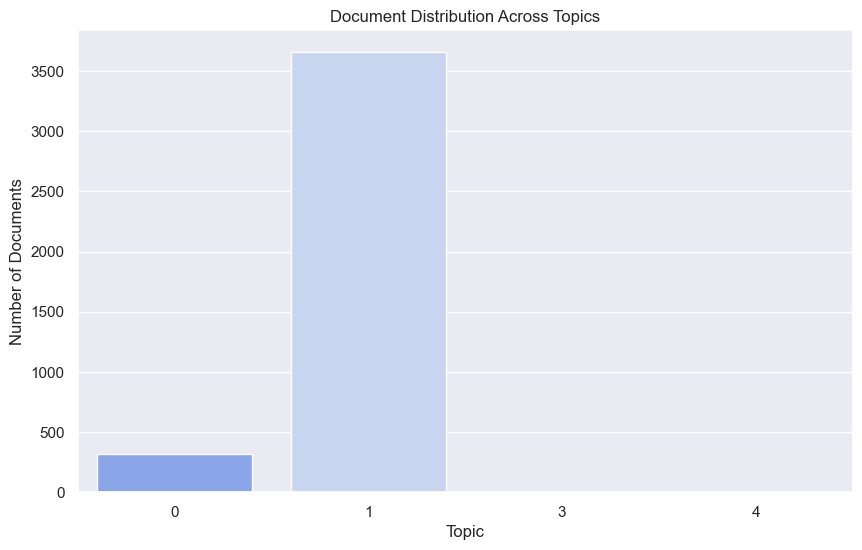

In [34]:
# Visualization of the dominant topics for the reviews

topic_counts = positive_reviews['Dominant_Topic'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=topic_counts.index, y=topic_counts.values, palette='coolwarm')
plt.xlabel('Topic')
plt.ylabel('Number of Documents')
plt.title('Document Distribution Across Topics')
#plt.xticks(rotation=45)  # Rotate the x labels if necessary
plt.show()

### 5b. Negative Sentiments

In [35]:
# tokenizing the reviews for LDA

# making a copy to the dataframe original reviews:
negative_reviews = negative_reviews.copy()

# Tokenize the text: split each string into a list of words
negative_reviews['tokenized_reviews'] = negative_reviews['cleaned_review'].apply(lambda x: x.split())

# create a dictionary representation of documents
dictionary = corpora.Dictionary(negative_reviews['tokenized_reviews'])

# convert dictionary into bag of words corpus
corpus = [dictionary.doc2bow(text) for text in negative_reviews['tokenized_reviews']]

In [36]:
# Build LDA model
lda_model_negative = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                            id2word=dictionary,
                                            num_topics=5,  # Adjust based on your needs
                                            random_state=100,
                                            update_every=1,
                                            chunksize=100,
                                            passes=10,
                                            alpha='auto',
                                            per_word_topics=True)

In [37]:
# to calculate coherence score for how interpretable the model is: 

# coherence score measures the degree of semantic similarity between high scoring words in the topic

# Calculate Coherence Score using the CoherenceModel
coherence_model_lda_negative = CoherenceModel(model=lda_model_negative, texts=negative_reviews['tokenized_reviews'], dictionary=dictionary, corpus=corpus, coherence='c_v')
coherence_lda_negative = coherence_model_lda_negative.get_coherence()

print('Coherence Score: ', coherence_lda_negative)

Coherence Score:  0.43535896648916117


In [38]:
#to view the topics by the LDA model
lda_model_negative.print_topics()

[(0,
  '0.025*"reception" + 0.025*"bit" + 0.023*"street" + 0.023*"furniture" + 0.022*"drink" + 0.022*"atmosphere" + 0.022*"shabby" + 0.022*"interior" + 0.021*"told" + 0.021*"decide"'),
 (1,
  '0.043*"tea" + 0.042*"coffee" + 0.037*"blind" + 0.036*"information" + 0.032*"work" + 0.032*"need" + 0.012*"staff" + 0.012*"two" + 0.011*"first" + 0.011*"room"'),
 (2,
  '0.062*"stop" + 0.037*"concierge" + 0.035*"though" + 0.035*"fault" + 0.034*"perfect" + 0.033*"sit" + 0.017*"bar" + 0.014*"sunday" + 0.013*"great" + 0.010*"get"'),
 (3,
  '0.042*"hotel" + 0.027*"lift" + 0.026*"away" + 0.024*"run" + 0.024*"without" + 0.023*"child" + 0.023*"enough" + 0.023*"come" + 0.023*"group" + 0.023*"afternoon"'),
 (4,
  '0.068*"room" + 0.033*"staff" + 0.029*"nothing" + 0.029*"location" + 0.026*"hotel" + 0.021*"good" + 0.018*"breakfast" + 0.016*"like" + 0.014*"poor" + 0.012*"bed"')]

In [39]:
# Prepare the visualization
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model_negative, corpus, dictionary)
pyLDAvis.display(vis)

#### Assign dominant topics to each row of data


In [40]:
# Step 1: Get topic distribution for each document
topic_distributions = [lda_model_negative.get_document_topics(bow) for bow in corpus]

# Step 2: Find the dominant topic for each document
dominant_topics = [sorted(topic_distribution, key=lambda x: x[1], reverse=True)[0][0] for topic_distribution in topic_distributions]

# Step 3: Assign the dominant topic to each row in the DataFrame
negative_reviews['Dominant_Topic'] = dominant_topics

# Optionally, add the contribution (percentage) of the dominant topic to each document
negative_reviews['Dominant_Topic_Contribution'] = [sorted(topic_distribution, key=lambda x: x[1], reverse=True)[0][1] for topic_distribution in topic_distributions]

#### Visualizing topics

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

/Users/chien/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead



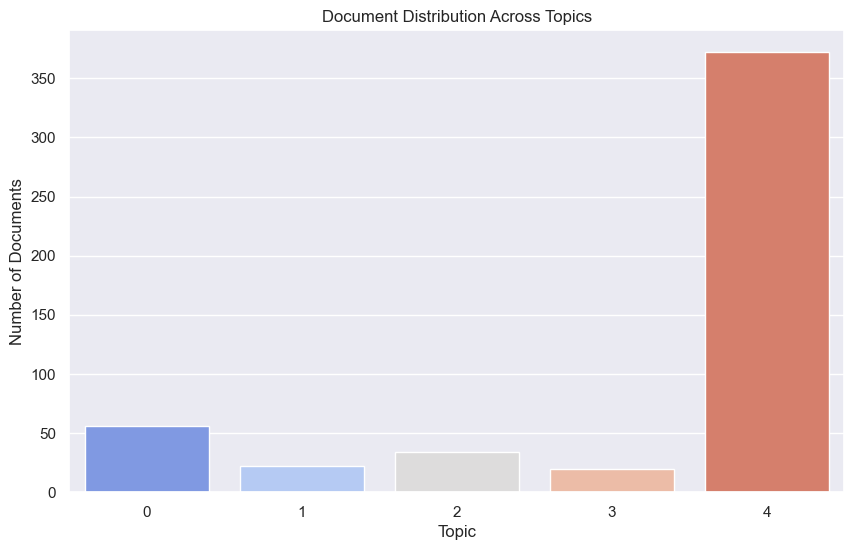

In [41]:
topic_counts = negative_reviews['Dominant_Topic'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=topic_counts.index, y=topic_counts.values, palette='coolwarm')
plt.xlabel('Topic')
plt.ylabel('Number of Documents')
plt.title('Document Distribution Across Topics')
#plt.xticks(rotation=45)  # Rotate the x labels if necessary
plt.show()

## 6. Feature Extraction with TF-IDF

## K-Means Clustering Analysis for positive and negative Sentiments

### Positive Sentiments

In [42]:
def get_tf_idf_matrix(sentences, max_features=10, min_df=5, max_df=0.5):
    vectorizer = TfidfVectorizer(stop_words='english', max_features=max_features, min_df=min_df, max_df=max_df)
    tfidf_matrix = vectorizer.fit_transform(sentences)
    feature_names = vectorizer.get_feature_names_out()
    return tfidf_matrix, feature_names

# Assume 'positive_reviews' is your DataFrame and 'cleaned_review' is the column with text data
# Here's how you would apply the function to your DataFrame
tfidf_matrix, feature_names = get_tf_idf_matrix(positive_reviews['cleaned_review'])
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=feature_names)
positive_reviews_tfidf = pd.concat([positive_reviews.reset_index(drop=True), tfidf_df], axis=1)


In [43]:
from sklearn.cluster import KMeans

# Number of clusters
n = 3
X = positive_reviews_tfidf.iloc[:, -10:]  

# Initialize the KMeans model
kmeans = KMeans(n_clusters=n, random_state=815)

# Add the cluster labels to the original reviews DataFrame
positive_reviews_tfidf['Cluster'] = kmeans.fit_predict(X)

/Users/chien/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



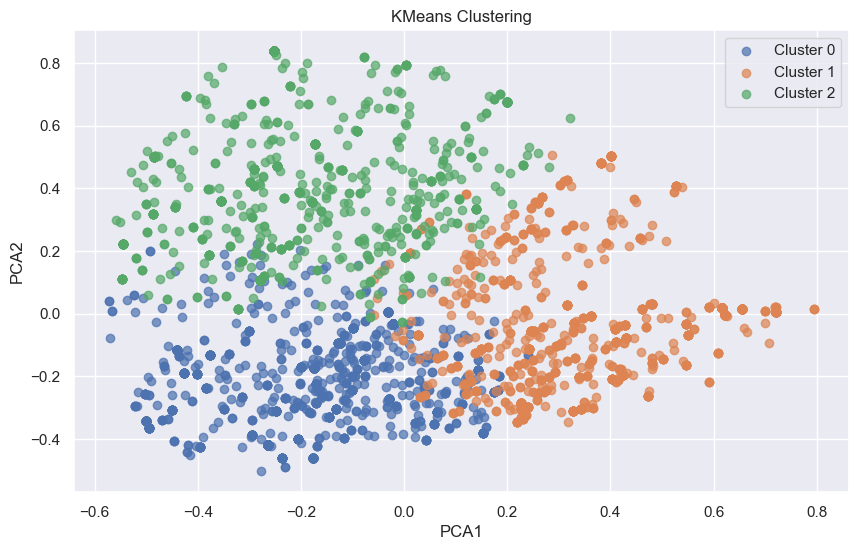

In [44]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Apply PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Add cluster labels to the reduced dataset
X_pca_df = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
X_pca_df['Cluster'] = positive_reviews_tfidf['Cluster']

# Plot clusters
plt.figure(figsize=(10, 6))
for cluster_label in range(n):
    plt.scatter(X_pca_df[X_pca_df['Cluster'] == cluster_label]['PCA1'], 
                X_pca_df[X_pca_df['Cluster'] == cluster_label]['PCA2'], 
                label=f'Cluster {cluster_label}', alpha=0.7)
plt.title('KMeans Clustering')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend()
plt.grid(True)
plt.show()

In [45]:
# Group the DataFrame by 'Cluster' and 'Hotel_Name', then count the occurrences
hotel_counts = positive_reviews_tfidf.groupby(['Cluster', 'Hotel_Name']).size().reset_index(name='Counts')

# Sort within each cluster by counts in descending order to get the most frequent hotels on top
hotel_counts_sorted = hotel_counts.sort_values(['Cluster', 'Counts'], ascending=[True, False])

# Get the order of the features for each cluster center from the KMeans model
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]

# Get the feature names from the TF-IDF vectorizer
terms = feature_names

# Now, for each cluster, display the top 5 most frequently mentioned hotel(s) and the top terms
for cluster_id in hotel_counts_sorted['Cluster'].unique():
    print(f"Cluster {cluster_id}:")
    print("\n")
    # Display the top terms for the cluster
    print("Top terms:")
    for ind in order_centroids[cluster_id, :5]:  # Display top 3 terms for brevity, adjust as needed
        print(f"- {terms[ind]}")
    print("\n")
    # Display the top 5 hotels
    top_hotels = hotel_counts_sorted[hotel_counts_sorted['Cluster'] == cluster_id].head(5)
    print("Top 5 Hotels:")
    for index, row in top_hotels.iterrows():
        print(f"- {row['Hotel_Name']} ({row['Counts']} reviews)")
    print()  # Add a blank line for better readability between hotels and terms


    print("\n" + "="*60 + "\n")  # Separator for clarity between clusters

Cluster 0:


Top terms:
- location
- good
- breakfast
- great
- bed


Top 5 Hotels:
- Britannia International Hotel Canary Wharf (18 reviews)
- DoubleTree by Hilton Hotel London Tower of London (14 reviews)
- Strand Palace Hotel (14 reviews)
- Doubletree by Hilton London Kensington (10 reviews)
- Holiday Inn London Bloomsbury (10 reviews)



Cluster 1:


Top terms:
- staff
- friendly
- helpful
- location
- great


Top 5 Hotels:
- Grand Royale London Hyde Park (14 reviews)
- Britannia International Hotel Canary Wharf (11 reviews)
- St James Court A Taj Hotel London (11 reviews)
- Strand Palace Hotel (11 reviews)
- Radisson Blu Edwardian Vanderbilt (10 reviews)



Cluster 2:


Top terms:
- hotel
- good
- location
- staff
- breakfast


Top 5 Hotels:
- Park Grand Paddington Court (8 reviews)
- M by Montcalm Shoreditch London Tech City (7 reviews)
- Hilton London Metropole (6 reviews)
- Intercontinental London The O2 (6 reviews)
- Park Plaza Westminster Bridge London (6 reviews)





### Negative Sentiments

In [46]:
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd

def get_tf_idf_matrix(sentences, max_features=10, min_df=5, max_df=0.5):
    vectorizer = TfidfVectorizer(stop_words='english', max_features=max_features, min_df=min_df, max_df=max_df)
    tfidf_matrix = vectorizer.fit_transform(sentences)
    feature_names = vectorizer.get_feature_names_out()
    return tfidf_matrix, feature_names

# Assume 'positive_reviews' is your DataFrame and 'cleaned_review' is the column with text data
# Here's how you would apply the function to your DataFrame
tfidf_matrix, feature_names = get_tf_idf_matrix(negative_reviews['cleaned_review'])
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=feature_names)
negative_reviews_tfidf = pd.concat([negative_reviews.reset_index(drop=True), tfidf_df], axis=1)

In [47]:
from sklearn.cluster import KMeans

# Number of clusters
n = 3
X = negative_reviews_tfidf.iloc[:, -10:]  

# Initialize the KMeans model
kmeans = KMeans(n_clusters=n, random_state=815)

# Add the cluster labels to the original reviews DataFrame
negative_reviews_tfidf['Cluster'] = kmeans.fit_predict(X)

/Users/chien/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



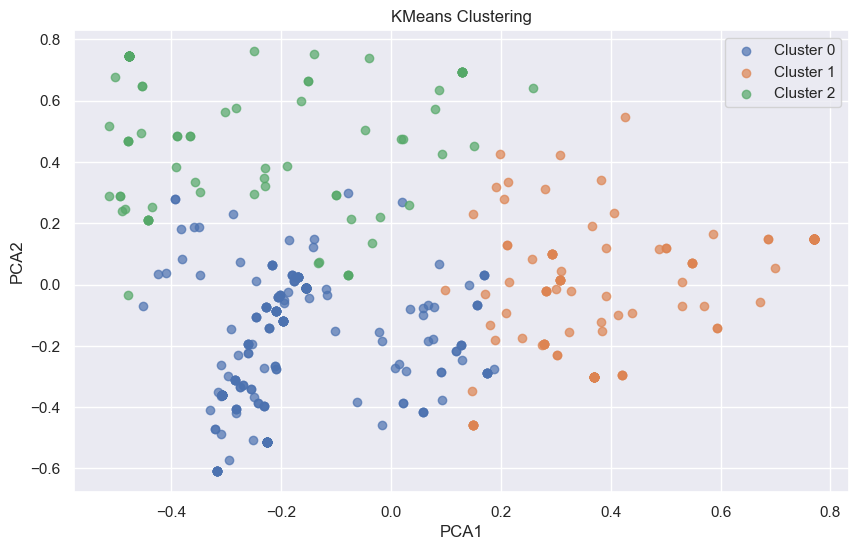

In [48]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Apply PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Add cluster labels to the reduced dataset
X_pca_df = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
X_pca_df['Cluster'] = negative_reviews_tfidf['Cluster']

# Plot clusters
plt.figure(figsize=(10, 6))
for cluster_label in range(n):
    plt.scatter(X_pca_df[X_pca_df['Cluster'] == cluster_label]['PCA1'], 
                X_pca_df[X_pca_df['Cluster'] == cluster_label]['PCA2'], 
                label=f'Cluster {cluster_label}', alpha=0.7)
plt.title('KMeans Clustering')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend()
plt.grid(True)
plt.show()

In [49]:
# Group the DataFrame by 'Cluster' and 'Hotel_Name', then count the occurrences
hotel_counts = negative_reviews_tfidf.groupby(['Cluster', 'Hotel_Name']).size().reset_index(name='Counts')

# Sort within each cluster by counts in descending order to get the most frequent hotels on top
hotel_counts_sorted = hotel_counts.sort_values(['Cluster', 'Counts'], ascending=[True, False])

# Get the order of the features for each cluster center from the KMeans model
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]

# Get the feature names from the TF-IDF vectorizer
terms = feature_names

# Now, for each cluster, display the top 5 most frequently mentioned hotel(s) and the top terms
for cluster_id in hotel_counts_sorted['Cluster'].unique():
    print(f"Cluster {cluster_id}:")
    print("\n")
    # Display the top terms for the cluster
    print("Top terms:")
    for ind in order_centroids[cluster_id, :5]:  # Display top 3 terms for brevity, adjust as needed
        print(f"- {terms[ind]}")
    print("\n")
    # Display the top 5 hotels
    top_hotels = hotel_counts_sorted[hotel_counts_sorted['Cluster'] == cluster_id].head(5)
    print("Top 5 Hotels:")
    for index, row in top_hotels.iterrows():
        print(f"- {row['Hotel_Name']} ({row['Counts']} reviews)")
    print()  # Add a blank line for better readability between hotels and terms


    print("\n" + "="*60 + "\n")  # Separator for clarity between clusters

Cluster 0:


Top terms:
- location
- staff
- breakfast
- poor
- bed


Top 5 Hotels:
- Britannia International Hotel Canary Wharf (5 reviews)
- Blakemore Hyde Park (4 reviews)
- Copthorne Tara Hotel London Kensington (4 reviews)
- Corus Hotel Hyde Park (4 reviews)
- DoubleTree by Hilton Hotel London Tower of London (3 reviews)



Cluster 1:


Top terms:
- room
- location
- staff
- bed
- breakfast


Top 5 Hotels:
- Park Plaza Westminster Bridge London (3 reviews)
- Apollo Hotel Amsterdam (2 reviews)
- Bloomsbury Palace Hotel (2 reviews)
- Brunelleschi Hotel (2 reviews)
- DoubleTree by Hilton Hotel London Tower of London (2 reviews)



Cluster 2:


Top terms:
- hotel
- room
- location
- staff
- stay


Top 5 Hotels:
- Britannia International Hotel Canary Wharf (3 reviews)
- Barcel Raval (2 reviews)
- Holiday Inn London Kensington (2 reviews)
- Holiday Inn London Kensington Forum (2 reviews)
- Ramada Apollo Amsterdam Centre (2 reviews)





## 7. Predictive Modelling

In [50]:
total_df= pd.concat([positive_reviews,negative_reviews]).reset_index(drop=True)

In [51]:
# Select all samples where 'Reviewer_Score' is less than 5
less_than_5_samples = total_df[total_df['Reviewer_Score'] < 5]

# Calculate the number of samples with 'Reviewer_Score' greater than 5
num_greater_than_5_samples = len(less_than_5_samples)

# Select samples where 'Reviewer_Score' is greater than 5
greater_than_5_samples = total_df[total_df['Reviewer_Score'] > 5].sample(n=num_greater_than_5_samples, random_state=42)

# Concatenate the selected samples
selected_samples = pd.concat([less_than_5_samples, greater_than_5_samples])

# Shuffle the concatenated DataFrame
selected_samples = selected_samples.sample(frac=1, random_state=42).reset_index(drop=True)

In [52]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Define features (X) and target variable (y)
X = selected_samples['cleaned_review']
y = (selected_samples['Reviewer_Score'] < 5).astype(int)  # Convert to binary labels: 1 if <5, 0 if >=5

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_features=500)

# Fit and transform the training data, transform the testing data
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

# Initialize the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model on the training data
rf_classifier.fit(X_train_tfidf, y_train)

# Predict on the testing data
y_pred = rf_classifier.predict(X_test_tfidf)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

Accuracy: 0.72
Classification Report:
              precision    recall  f1-score   support

           0       0.66      0.81      0.72        31
           1       0.80      0.65      0.72        37

    accuracy                           0.72        68
   macro avg       0.73      0.73      0.72        68
weighted avg       0.74      0.72      0.72        68



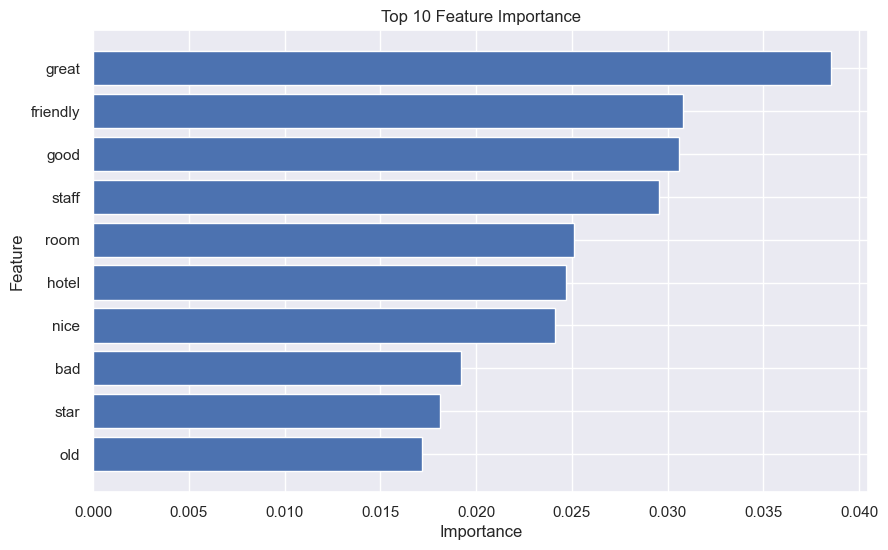

In [53]:
import matplotlib.pyplot as plt

# Get feature importance
feature_importance = rf_classifier.feature_importances_

# Get the names of the features (words in this case) from the TF-IDF vectorizer
feature_names = tfidf_vectorizer.get_feature_names_out()

# Create a DataFrame to store feature names and their importance
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importance})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'][:10], feature_importance_df['Importance'][:10])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 10 Feature Importance')
plt.gca().invert_yaxis()  # Invert y-axis to show the most important features at the top
plt.show()
